<a href="https://colab.research.google.com/github/AeroEng16/FootballAnalysis/blob/main/workingWithExampleTrackingData.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import requests
import re
import json
import datetime
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from PIL import Image, ImageDraw
from io import BytesIO
import yaml
import os
;

''

In [2]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Mounted at /content/drive


# Skill Corner Data


In [ ]:
running = True

In [ ]:
import requests
import json

url = "https://raw.githubusercontent.com/SkillCorner/opendata/master/data/matches/2068/match_data.json"

respKeys = requests.get(url)
matchKeyData = json.loads(respKeys.text)

url = "https://raw.githubusercontent.com/SkillCorner/opendata/master/data/matches/2068/structured_data.json"
respTrack = requests.get(url)
matchTrackingData = json.loads(respTrack.text)


In [ ]:
#Create Lookuptable for player ids and teams to update pandas df
homeTeamID = matchKeyData["home_team"]["id"]
awayTeamID = matchKeyData["away_team"]["id"]
idLUT = [{str(x["trackable_object"]):(lambda x: "home team" if x["team_id"] == homeTeamID else "away team")(x)} for x in matchKeyData["players"]]
idLUT={k: v for d in idLUT for k, v in d.items()}
idLUT["55"]="ball"


In [ ]:
# Define lines for pitch for heatmaps etc.
pitchLength =matchKeyData["pitch_length"]
pitchWidth =matchKeyData["pitch_width"]
touchLineDimensionsX = [-pitchLength/2,pitchLength/2,pitchLength/2,-pitchLength/2,-pitchLength/2]
touchLineDimensionsY = [pitchWidth/2,pitchWidth/2,-pitchWidth/2,-pitchWidth/2,pitchWidth/2]
centrelineX = [0,0]
centrelineY = [-pitchWidth/2,pitchWidth/2]
goalLineX = [-pitchLength/2,-pitchLength/2]
goalLineY = [-7.32/2,7.32/2]
smallBoxX = [-pitchLength/2,(-pitchLength/2)+5.5,(-pitchLength/2)+5.5,-pitchLength/2]
smallBoxY = [(-7.32/2)-5.5,(-7.32/2)-5.5,(7.32/2)+5.5,(7.32/2)+5.5]
bigBoxX = [-pitchLength/2,(-pitchLength/2)+5.5+11,(-pitchLength/2)+5.5+11,-pitchLength/2]
bigBoxY = [(-7.32/2)-5.5-11,(-7.32/2)-5.5-11,(7.32/2)+5.5+11,(7.32/2)+5.5+11]

penaltySpot = [-pitchLength/2+11]


In [ ]:
## Filter json to ignore unimportant items

filteredMatchTrackingData = [x for x in matchTrackingData if len(x['data'])!=0]


In [ ]:
#Flatten to list of tracked items
flattenedMatchTrackingData = [[dict({i:x[i] for i in x if i!='data'},**dataDict) for dataDict in x['data']] for x in filteredMatchTrackingData]

flattenedMatchTrackingData = [
    x
    for xs in flattenedMatchTrackingData
    for x in xs
]


In [ ]:
df = pd.json_normalize(flattenedMatchTrackingData)


In [ ]:
df['group_name'] = df.trackable_object.fillna(0).astype(int).astype(str).map(idLUT)


In [ ]:
fig = px.density_heatmap(df, x="x", y="y", nbinsx=pitchLength, nbinsy=pitchWidth, color_continuous_scale="Viridis")
fig.add_trace(go.Scatter(x=touchLineDimensionsX,y=touchLineDimensionsY,mode='lines',line=dict(color="white")))
fig.add_trace(go.Scatter(x=goalLineX,y=goalLineY,mode='lines',line=dict(color="red")))
fig.add_trace(go.Scatter(x=smallBoxX,y=smallBoxY,mode='lines',line=dict(color="white")))
fig.add_trace(go.Scatter(x=bigBoxX,y=bigBoxY,mode='lines',line=dict(color="white")))
fig.add_trace(go.Scatter(x=centrelineX,y=centrelineY,mode='lines',line=dict(color="white")))

fig.add_trace(go.Scatter(x=[-1*x for x in goalLineX],y=goalLineY,mode='lines',line=dict(color="red")))
fig.add_trace(go.Scatter(x=[-1*x for x in smallBoxX],y=smallBoxY,mode='lines',line=dict(color="white")))
fig.add_trace(go.Scatter(x=[-1*x for x in bigBoxX],y=bigBoxY,mode='lines',line=dict(color="white")))



fig.add_shape(type="circle",
    xref="x", yref="y",
    x0=-9.15, y0=-9.15, x1=9.15, y1=9.15,
    line_color="White",
)



fig.update_layout(yaxis_range=[-pitchWidth/2-1,pitchWidth/2+1],xaxis_range=[-pitchLength/2-1,pitchLength/+1],
                  yaxis=dict(scaleanchor="x", scaleratio=1),
                  showlegend=False)
fig.show()


In [ ]:

if running == True:

  testDf = df[~df['group_name'].isna()].iloc[4000:6000].copy(deep=True)


  fig  = px.scatter(testDf,x='x',y='y',color="group_name",animation_frame = "frame", animation_group="track_id")


  fig.add_trace(go.Scatter(x=touchLineDimensionsX,y=touchLineDimensionsY,mode='lines',line=dict(color="white")))
  fig.add_trace(go.Scatter(x=touchLineDimensionsX,y=touchLineDimensionsY,mode='lines',line=dict(color="white")))
  fig.add_trace(go.Scatter(x=goalLineX,y=goalLineY,mode='lines',line=dict(color="red")))
  fig.add_trace(go.Scatter(x=[-1*x for x in goalLineX],y=goalLineY,mode='lines',line=dict(color="red")))
  fig.add_trace(go.Scatter(x=smallBoxX,y=smallBoxY,mode='lines',line=dict(color="white")))
  fig.add_trace(go.Scatter(x=bigBoxX,y=bigBoxY,mode='lines',line=dict(color="white")))
  fig.add_trace(go.Scatter(x=centrelineX,y=centrelineY,mode='lines',line=dict(color="white")))

  fig.add_shape(type="circle",
      xref="x", yref="y",
      x0=-9.15, y0=-9.15, x1=9.15, y1=9.15,
      line_color="White",
  )



  fig.add_trace(go.Scatter(x=[-1*x for x in smallBoxX],y=smallBoxY,mode='lines',line=dict(color="white")))
  fig.add_trace(go.Scatter(x=[-1*x for x in bigBoxX],y=bigBoxY,mode='lines',line=dict(color="white")))

  fig.update_layout(yaxis_range=[-pitchWidth/2-1,pitchWidth/2+1],
                    xaxis_range=[-pitchLength/2-1,pitchLength/2+1],
                    yaxis=dict(scaleanchor="x", scaleratio=1),
                    showlegend=False,plot_bgcolor='green' )
  fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 100
  fig.layout.updatemenus[0].buttons[0].args[1]['transition']['duration'] = 10
  fig.update_xaxes(visible=False)
  fig.update_yaxes(visible=False)
  fig.show()


# StatsBomb Data


In [3]:
try:
  from statsbombpy import sb
except ModuleNotFoundError:
  !pip install statsbombpy
  from statsbombpy import sb
import numpy as np
import pandas as pd
import plotly.express as px
from plotly.subplots import make_subplots
import datetime
from itertools import chain
import csv
from ast import literal_eval
import math


pd.set_option('display.max_rows', 99999)
pd.set_option('max_colwidth', 400)


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.7/63.7 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.4/61.4 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.4/66.4 kB 6.7 MB/s eta 0:00:00


## Data Available Exploration

In [ ]:
comps = sb.competitions()
available360Data = comps[~comps['match_available_360'].isnull()]
available360Data.head(15)


/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning: credentials were not supplied. open data access only
  warnings.warn(


,competition_id,season_id,country_name,competition_name,competition_gender,competition_youth,competition_international,season_name,match_updated,match_updated_360,match_available_360,match_available
0,9,281,Germany,1. Bundesliga,male,False,False,2023/2024,2024-07-15T14:15:54.671676,2024-07-15T14:17:00.877356,2024-07-15T14:17:00.877356,2024-07-15T14:15:54.671676
29,43,106,International,FIFA World Cup,male,False,True,2022,2024-05-15T10:23:32.854925,2024-06-11T11:30:50.462448,2024-06-11T11:30:50.462448,2024-05-15T10:23:32.854925
38,11,90,Spain,La Liga,male,False,False,2020/2021,2024-07-15T15:15:28.367546,2024-07-15T15:17:45.455234,2024-07-15T15:17:45.455234,2024-07-15T15:15:28.367546
58,7,235,France,Ligue 1,male,False,False,2022/2023,2024-06-11T00:50:53.277411,2024-06-26T08:17:36.043856,2024-06-26T08:17:36.043856,2024-06-11T00:50:53.277411
59,7,108,France,Ligue 1,male,False,False,2021/2022,2024-06-03T16:46:00.665854,2024-06-03T16:49:55.355195,2024-06-03T16:49:55.355195,2024-06-03T16:46:00.665854
61,44,107,United States of America,Major League Soccer,male,False,False,2023,2024-07-14T18:53:28.735163,2024-07-14T18:58:42.974543,2024-07-14T18:58:42.974543,2024-07-14T18:53:28.735163
68,55,282,Europe,UEFA Euro,male,False,True,2024,2024-07-15T15:48:50.315500,2024-07-15T15:52:24.778809,2024-07-15T15:52:24.778809,2024-07-15T15:48:50.315500
69,55,43,Europe,UEFA Euro,male,False,True,2020,2024-04-16T12:44:40.558402,2024-04-16T12:47:18.505110,2024-04-16T12:47:18.505110,2024-04-16T12:44:40.558402
71,53,106,Europe,UEFA Women's Euro,female,False,True,2022,2024-02-13T13:27:17.178263,2024-02-13T13:30:52.820588,2024-02-13T13:30:52.820588,2024-02-13T13:27:17.178263
72,72,107,International,Women's World Cup,female,False,True,2023,2024-07-14T16:59:48.469596,2024-07-14T17:01:38.887279,2024-07-14T17:01:38.887279,2024-07-14T16:59:48.469596


In [ ]:
leverkusenMatches = sb.matches(competition_id=9, season_id=281)
mensWCMatches = sb.matches(competition_id=43, season_id=106)
mensEuros24 =sb.matches(competition_id = 55, season_id = 282)
mensEuros20 =sb.matches(competition_id = 55, season_id = 43)
mensWCMatches


/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning: credentials were not supplied. open data access only
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning: credentials were not supplied. open data access only
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning: credentials were not supplied. open data access only
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning: credentials were not supplied. open data access only
  warnings.warn(


,match_id,match_date,kick_off,competition,season,home_team,away_team,home_score,away_score,match_status,...,last_updated_360,match_week,competition_stage,stadium,referee,home_managers,away_managers,data_version,shot_fidelity_version,xy_fidelity_version
0,3857256,2022-12-02,21:00:00.000,International - FIFA World Cup,2022,Serbia,Switzerland,2,3,available,...,2023-04-26T23:49:58.956186,3,Group Stage,Stadium 974,Fernando Andrés Rapallini,Dragan Stojković,Murat Yakin,1.1.0,2,2
1,3869151,2022-12-03,21:00:00.000,International - FIFA World Cup,2022,Argentina,Australia,2,1,available,...,2023-07-30T07:48:51.865595,4,Round of 16,Ahmad bin Ali Stadium,Szymon Marciniak,Lionel Sebastián Scaloni,Graham James Arnold,1.1.0,2,2
2,3857257,2022-11-30,17:00:00.000,International - FIFA World Cup,2022,Australia,Denmark,1,0,available,...,2023-06-20T11:04:37.638969,3,Group Stage,Al Janoub Stadium,Mustapha Ghorbal,Graham James Arnold,Kasper Hjulmand,1.1.0,2,2
3,3857258,2022-11-24,21:00:00.000,International - FIFA World Cup,2022,Brazil,Serbia,2,0,available,...,2023-07-11T14:56:31.096588,1,Group Stage,Lusail Stadium,Alireza Faghani,Telê Santana da Silva,Dragan Stojković,1.1.0,2,2
4,3857288,2022-11-26,12:00:00.000,International - FIFA World Cup,2022,Tunisia,Australia,0,1,available,...,2023-04-27T00:30:07.835815,2,Group Stage,Al Janoub Stadium,Daniel Siebert,Jalel Kadri,Graham James Arnold,1.1.0,2,2
5,3857267,2022-11-29,17:00:00.000,International - FIFA World Cup,2022,Ecuador,Senegal,1,2,available,...,2023-05-19T13:52:07.885530,3,Group Stage,Sheikh Khalifa International Stadium,Clément Turpin,Gustavo Julio Alfaro,Aliou Cissé,1.1.0,2,2
6,3869321,2022-12-09,21:00:00.000,International - FIFA World Cup,2022,Netherlands,Argentina,2,2,available,...,2023-06-21T17:51:12.511460,5,Quarter-finals,Lusail Stadium,Antonio Miguel Mateu Lahoz,Louis van Gaal,Lionel Sebastián Scaloni,1.1.0,2,2
7,3857287,2022-11-24,15:00:00.000,International - FIFA World Cup,2022,Uruguay,South Korea,0,0,available,...,2023-04-27T00:36:59.281195,1,Group Stage,Education City Stadium,Clément Turpin,Diego Martín Alonso López,Paulo Jorge Gomes Bento,1.1.0,2,2
8,3869486,2022-12-10,17:00:00.000,International - FIFA World Cup,2022,Morocco,Portugal,1,0,available,...,2023-04-26T23:03:02.645780,5,Quarter-finals,Al Thumama Stadium,Facundo Tello Figueroa,Hoalid Regragui,Fernando Manuel Fernandes da Costa Santos,1.1.0,2,2
9,3869685,2022-12-18,17:00:00.000,International - FIFA World Cup,2022,Argentina,France,3,3,available,...,2023-08-17T15:55:15.164685,7,Final,Lusail Stadium,Szymon Marciniak,Lionel Sebastián Scaloni,Didier Deschamps,1.1.0,2,2


In [ ]:
match_frames = sb.frames(3857261)
match_events = sb.events(3857261)

team1 = 'England'
team2 = 'Wales'
colorTeam1 = 'white'
colorTeam2 = 'red'

matchData = pd.merge(match_frames,match_events,on=['id'])
matchData['Time'] = matchData.apply(lambda x: datetime.time(hour=0, minute=x.minute,second=x.second) if x.minute<60 else datetime.time(hour=1, minute=x.minute-60,second=x.second) , axis=1)
matchData['plotColor'] = matchData.apply(lambda x: colorTeam1 if x['team'] == team1 else colorTeam2, axis=1)
matchData['plotSymbol'] = matchData.apply(lambda x: 'actor' if x['actor'] == True else 'otherPlayer', axis=1)
matchData.columns.values

/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning: credentials were not supplied. open data access only
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning: credentials were not supplied. open data access only
  warnings.warn(


array(['id', 'visible_area', 'match_id_x', 'teammate', 'actor', 'keeper',
       'location_x', '50_50', 'ball_receipt_outcome',
       'ball_recovery_offensive', 'ball_recovery_recovery_failure',
       'block_deflection', 'carry_end_location', 'clearance_aerial_won',
       'clearance_body_part', 'clearance_head', 'clearance_left_foot',
       'clearance_right_foot', 'counterpress', 'dribble_nutmeg',
       'dribble_outcome', 'dribble_overrun', 'duel_outcome', 'duel_type',
       'duration', 'foul_committed_advantage', 'foul_committed_card',
       'foul_committed_type', 'foul_won_advantage', 'foul_won_defensive',
       'goalkeeper_body_part', 'goalkeeper_end_location',
       'goalkeeper_outcome', 'goalkeeper_position',
       'goalkeeper_technique', 'goalkeeper_type', 'index',
       'injury_stoppage_in_chain', 'interception_outcome', 'location_y',
       'match_id_y', 'minute', 'miscontrol_aerial_won', 'off_camera',
       'out', 'pass_aerial_won', 'pass_angle', 'pass_assisted_sho

## Pitch Definition

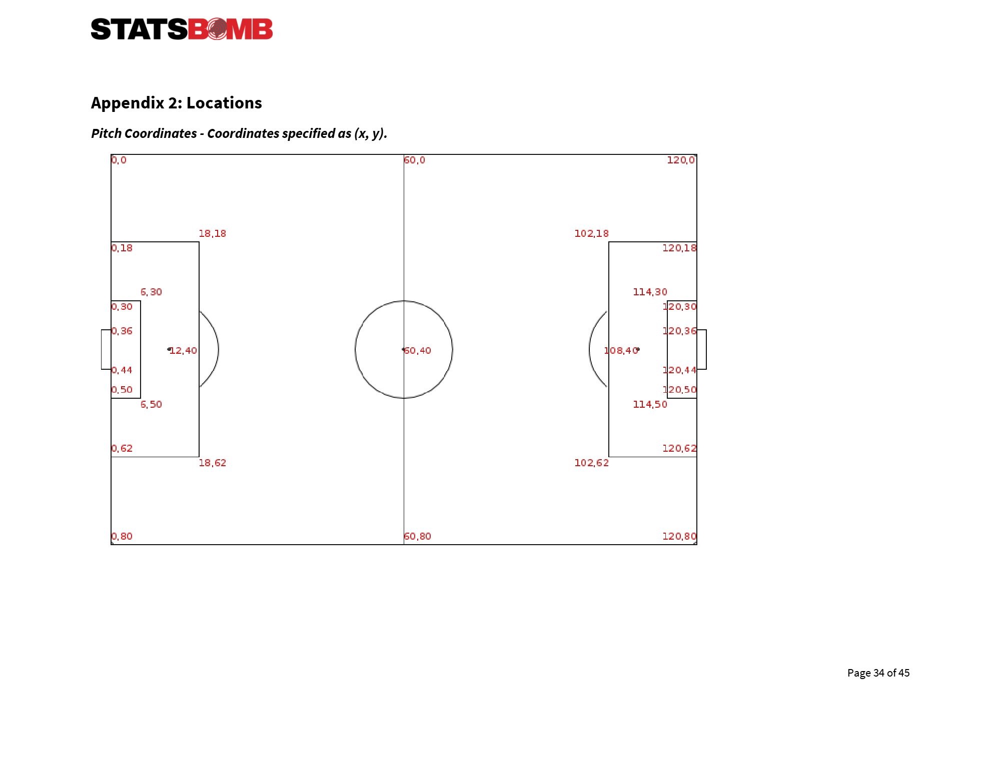

In [10]:
# Define lines for pitch for heatmaps etc.
pitchLength = 120
pitchWidth = 80
touchLineDimensionsX = [0,pitchLength,pitchLength,0,0]
touchLineDimensionsY = [pitchWidth,pitchWidth,0,0,pitchWidth]
centrelineX = [pitchLength/2,pitchLength/2]
centrelineY = [0,pitchWidth]
goalLineX = [0,0]
goalLineX_2nd = [pitchLength,pitchLength]
goalLineY = [36,44]
smallBoxX = [0,6,6,0]
smallBoxX_2nd = [pitchLength,pitchLength-6,pitchLength-6,pitchLength]
smallBoxY = [30,30,50,50]
bigBoxX = [0,18,18,0]
bigBoxX_2nd = [pitchLength,pitchLength-18,pitchLength-18,pitchLength]
bigBoxY = [18,18,62,62]
circleBottomLeft = [50,30]
circleTopRight = [70,50]
penaltySpot = [12,40]
centerSpot = [60,40]

## Plot Player Specific Data for a Game

In [ ]:
player = 'Marcus Rashford'
playerSpecificData = matchData[(matchData['player']==player) & (matchData['actor']==True)]
print(list(playerSpecificData.type.unique()))
playerSpecificData[['X','Y']] = pd.DataFrame(playerSpecificData.location_x.tolist(),index=playerSpecificData.index)


['Ball Receipt*', 'Carry', 'Pass', 'Ball Recovery', 'Shot', 'Dribble', 'Duel', 'Miscontrol', 'Pressure']


<ipython-input-21-e750c7e67848>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-21-e750c7e67848>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# Add visible area polygon to each frame
frames = []
sliders_dict = {
    "active": 0,
    "yanchor": "top",
    "xanchor": "left",
    "steps":[]}
#for frameNum, frame in enumerate(fig.frames):
for frameNum in range(0,len(playerSpecificData.id.unique())):
    currentVisibleArea = playerSpecificData.iloc[frameNum].visible_area
    xVals = currentVisibleArea[::2]
    yVals = currentVisibleArea[1::2]
    if frameNum ==0:
      pitchData = [
      go.Scatter(x = xVals, y = yVals, fill="toself"),
      go.Scatter(x=[playerSpecificData.iloc[frameNum].X], y=[playerSpecificData.iloc[frameNum].Y], mode='markers', marker=dict(color='red', size=10)) ,
      go.Scatter(x=touchLineDimensionsX,y=touchLineDimensionsY,mode='lines',line=dict(color="white")),
      go.Scatter(x=touchLineDimensionsX,y=touchLineDimensionsY,mode='lines',line=dict(color="white")),
      go.Scatter(x=goalLineX,y=goalLineY,mode='lines',line=dict(color="red")),
      go.Scatter(x=goalLineX_2nd,y=goalLineY,mode='lines',line=dict(color="red")),
      go.Scatter(x=smallBoxX,y=smallBoxY,mode='lines',line=dict(color="white")),
      go.Scatter(x=bigBoxX,y=bigBoxY,mode='lines',line=dict(color="white")),
      go.Scatter(x=centrelineX,y=centrelineY,mode='lines',line=dict(color="white")),
      go.Scatter(x=smallBoxX_2nd,y=smallBoxY,mode='lines',line=dict(color="white")),
      go.Scatter(x=bigBoxX_2nd,y=bigBoxY,mode='lines',line=dict(color="white"))
  ]


    frames.append(go.Frame(data=[
        go.Scatter(x = xVals, y = yVals, fill="toself"),
        go.Scatter(x=[playerSpecificData.iloc[frameNum].X], y=[playerSpecificData.iloc[frameNum].Y], mode='markers', marker=dict(color='red', size=10)) ,
            go.Scatter(x=touchLineDimensionsX,y=touchLineDimensionsY,mode='lines',line=dict(color="white")),
    go.Scatter(x=touchLineDimensionsX,y=touchLineDimensionsY,mode='lines',line=dict(color="white")),
    go.Scatter(x=goalLineX,y=goalLineY,mode='lines',line=dict(color="red")),
    go.Scatter(x=goalLineX_2nd,y=goalLineY,mode='lines',line=dict(color="red")),
    go.Scatter(x=smallBoxX,y=smallBoxY,mode='lines',line=dict(color="white")),
    go.Scatter(x=bigBoxX,y=bigBoxY,mode='lines',line=dict(color="white")),
    go.Scatter(x=centrelineX,y=centrelineY,mode='lines',line=dict(color="white")),
    go.Scatter(x=smallBoxX_2nd,y=smallBoxY,mode='lines',line=dict(color="white")),
    go.Scatter(x=bigBoxX_2nd,y=bigBoxY,mode='lines',line=dict(color="white")),

    ],name=frameNum))
    slider_step = {"args": [
        [frameNum],
        {"frame": {"duration": 300, "redraw": False},
         "mode": "immediate",
         "transition": {"duration": 300}}
    ],
        "label": frameNum,
        "method": "animate"}
    sliders_dict["steps"].append(slider_step)



fig = go.Figure(data = pitchData,frames = frames,layout=go.Layout(
        updatemenus=[dict(
            type="buttons",
            buttons=[dict(label="Play",
                          method="animate",
                          args=[None])])],
        sliders = [sliders_dict],
    ),)

fig.update_layout(yaxis_range=[-1,pitchWidth/1],
                  xaxis_range=[-1,pitchLength+1],
                  yaxis=dict(scaleanchor="x", scaleratio=1),
                  showlegend=False,plot_bgcolor='green' )
#fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 100
#fig.layout.updatemenus[0].buttons[0].args[1]['transition']['duration'] = 10
fig.update_xaxes(visible=False)
fig.update_yaxes(visible=False)


fig.add_shape(type="circle",
    xref="x", yref="y",
    x0=51.85, y0=30.85, x1=69.15, y1=49.15,
    line_color="White",
)


fig.show()

## Plot all players for each frame

In [ ]:
frameIDs = matchData.id.unique()

# Add visible area polygon to each frame
frames = []
sliders_dict = {
    "active": 0,
    "yanchor": "top",
    "xanchor": "left",
    "steps":[]}

framesToShow = int(len(frameIDs))

for frameNum in range(0,framesToShow):
    # Create local df just with current frame and add plotColor and symbols
    localDf = matchData[matchData['id']==frameIDs[frameNum]]
    localDf[['X','Y']] = pd.DataFrame(localDf.location_x.tolist(),index=localDf.index)

    currentVisibleArea = localDf.iloc[0].visible_area
    xVals = currentVisibleArea[::2]
    yVals = currentVisibleArea[1::2]

    tempFig = px.scatter(localDf,x='X',y='Y',color='plotColor',symbol='plotSymbol')

    if frameNum ==0:
      pitchData = [
      go.Scatter(x = xVals, y = yVals, fill="toself"),
      tempFig.data[0],
      go.Scatter(x=touchLineDimensionsX,y=touchLineDimensionsY,mode='lines',line=dict(color="white")),
      go.Scatter(x=touchLineDimensionsX,y=touchLineDimensionsY,mode='lines',line=dict(color="white")),
      go.Scatter(x=goalLineX,y=goalLineY,mode='lines',line=dict(color="red")),
      go.Scatter(x=goalLineX_2nd,y=goalLineY,mode='lines',line=dict(color="red")),
      go.Scatter(x=smallBoxX,y=smallBoxY,mode='lines',line=dict(color="white")),
      go.Scatter(x=bigBoxX,y=bigBoxY,mode='lines',line=dict(color="white")),
      go.Scatter(x=centrelineX,y=centrelineY,mode='lines',line=dict(color="white")),
      go.Scatter(x=smallBoxX_2nd,y=smallBoxY,mode='lines',line=dict(color="white")),
      go.Scatter(x=bigBoxX_2nd,y=bigBoxY,mode='lines',line=dict(color="white"))]

    frames.append(go.Frame(data=[
        go.Scatter(x = xVals, y = yVals, fill="toself"),
        tempFig.data[0],
        go.Scatter(x=touchLineDimensionsX,y=touchLineDimensionsY,mode='lines',line=dict(color="white")),
        go.Scatter(x=touchLineDimensionsX,y=touchLineDimensionsY,mode='lines',line=dict(color="white")),
        go.Scatter(x=goalLineX,y=goalLineY,mode='lines',line=dict(color="red")),
        go.Scatter(x=goalLineX_2nd,y=goalLineY,mode='lines',line=dict(color="red")),
        go.Scatter(x=smallBoxX,y=smallBoxY,mode='lines',line=dict(color="white")),
        go.Scatter(x=bigBoxX,y=bigBoxY,mode='lines',line=dict(color="white")),
        go.Scatter(x=centrelineX,y=centrelineY,mode='lines',line=dict(color="white")),
        go.Scatter(x=smallBoxX_2nd,y=smallBoxY,mode='lines',line=dict(color="white")),
        go.Scatter(x=bigBoxX_2nd,y=bigBoxY,mode='lines',line=dict(color="white")),
    ],name=frameNum))
    slider_step = {"args": [
        [frameNum],
        {"frame": {"duration": 300, "redraw": False},
         "mode": "immediate",
         "transition": {"duration": 300}}
    ],
        "label": frameNum,
        "method": "animate"}
    sliders_dict["steps"].append(slider_step)


fig = go.Figure(data = pitchData,frames = frames,layout=go.Layout(
        updatemenus=[dict(
            type="buttons",
            buttons=[dict(label="Play",
                          method="animate",
                          args=[None])])],
        sliders = [sliders_dict],
    ),)

fig.update_layout(yaxis_range=[-1,pitchWidth/1],
                  xaxis_range=[-1,pitchLength+1],
                  yaxis=dict(scaleanchor="x", scaleratio=1),
                  showlegend=False,plot_bgcolor='green' )
#fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 100
#fig.layout.updatemenus[0].buttons[0].args[1]['transition']['duration'] = 10
fig.update_xaxes(visible=False)
fig.update_yaxes(visible=False)


fig.add_shape(type="circle",
    xref="x", yref="y",
    x0=51.85, y0=30.85, x1=69.15, y1=49.15,
    line_color="White",
)

fig.write_html('test.html')
fig.show()



Streaming output truncated to the last 5000 lines.
<ipython-input-35-43f3c9dfe8a1>:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-35-43f3c9dfe8a1>:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-35-43f3c9dfe8a1>:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

In [ ]:
tempFig.data[0]

Scatter({
    'hovertemplate': 'plotColor=white<br>X=%{x}<br>Y=%{y}<extra></extra>',
    'legendgroup': 'white',
    'marker': {'color': '#636efa', 'symbol': 'circle'},
    'mode': 'markers',
    'name': 'white',
    'orientation': 'v',
    'showlegend': True,
    'x': array([56.94031058, 64.5       , 65.14603091, 65.67297994, 66.58864891,
                69.99924046, 71.0983978 , 76.32452739, 76.40170662, 82.44720142,
                83.02219598, 85.97853132, 86.58704936, 87.77881817, 87.81566711,
                90.64253819, 92.07322013]),
    'xaxis': 'x',
    'y': array([34.42152781, 47.5       , 39.81226685, 53.61458057, 18.80030212,
                74.14756941, 56.43245985, 46.06248366, 36.53305201, 25.88657106,
                23.006433  , 16.31487444, 61.20508895, 39.34036567, 33.49790433,
                28.00556146, 56.22750172]),
    'yaxis': 'y'
})

## Extract all event data for 2015/2016 season and analyse for comparison to recent data (e.g. Mbappe, Kane, etc.)

### Import Relevant Data

In [18]:
prem_15_16 = sb.matches(competition_id=2, season_id=27)
serieA_15_16 = sb.matches(competition_id=12, season_id=27)
laliga_15_16 = sb.matches(competition_id=11, season_id=27)
ligue1_15_16 = sb.matches(competition_id=7, season_id=27)
bundesliga_15_16 = sb.matches(competition_id=9, season_id=27)

prem_MatchIds = prem_15_16.match_id.unique()
serie_MatchIds = serieA_15_16.match_id.unique()
laliga_MatchIds = laliga_15_16.match_id.unique()
ligue1_MatchIds = ligue1_15_16.match_id.unique()
bundesliga_MatchIds = bundesliga_15_16.match_id.unique()

player_TeamDict = {
    "Luis Alberto Suárez Díaz": "Barcelona",
    "Lionel Andrés Messi Cuccittini": "Barcelona",
    "Neymar da Silva Santos Junior": "Barcelona",
    "Jamie Vardy": "Leicester City",
    "Sergio Leonel Agüero del Castillo": "Manchester City",
    "Harry Kane": "Tottenham Hotspur",
    "Gonzalo Gerardo Higuaín": "Napoli",
    "Paulo Bruno Exequiel Dybala": "Juventus",
    "Mohamed Salah": "AS Roma",
    "Robert Lewandowski": "Bayern Munich",
    "Pierre-Emerick Aubameyang": "Borussia Dortmund",
    "Thomas Muller": "Bayern Munich",
    "Zlatan Ibrahimovic": "Paris Saint-Germain",
    "Alexandre Lacazette": "Lyon"

}
match_events = sb.events(3754058)

print(match_events.columns.values)
match_events[["player","location","type","team","substitution_outcome","substitution_replacement"]][match_events.type == "Substitution"].head(25)

#Under substitution "player" column indicates player coming off and substitution_replacement indicates player coming on.

# Player to look at data for Suarez, CR7, messi, neymar, vardy, kane aguero, higuain, dybala, salah, Lewandowski, Aubameyang, Muller, Zlatan, Lacazette

/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning:

credentials were not supplied. open data access only

/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning:

credentials were not supplied. open data access only

/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning:

credentials were not supplied. open data access only

/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning:

credentials were not supplied. open data access only

/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning:

credentials were not supplied. open data access only

/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning:

credentials were not supplied. open data access only



['ball_receipt_outcome' 'ball_recovery_recovery_failure'
 'carry_end_location' 'clearance_aerial_won' 'clearance_body_part'
 'clearance_head' 'clearance_left_foot' 'clearance_right_foot'
 'counterpress' 'dribble_nutmeg' 'dribble_outcome' 'dribble_overrun'
 'duel_outcome' 'duel_type' 'duration' 'foul_committed_advantage'
 'foul_committed_card' 'foul_committed_offensive' 'foul_committed_penalty'
 'foul_committed_type' 'foul_won_advantage' 'foul_won_defensive'
 'foul_won_penalty' 'goalkeeper_body_part' 'goalkeeper_end_location'
 'goalkeeper_outcome' 'goalkeeper_position' 'goalkeeper_punched_out'
 'goalkeeper_technique' 'goalkeeper_type' 'id' 'index'
 'interception_outcome' 'location' 'match_id' 'minute'
 'miscontrol_aerial_won' 'off_camera' 'out' 'pass_aerial_won' 'pass_angle'
 'pass_assisted_shot_id' 'pass_body_part' 'pass_cross' 'pass_cut_back'
 'pass_deflected' 'pass_end_location' 'pass_height' 'pass_inswinging'
 'pass_length' 'pass_outcome' 'pass_outswinging' 'pass_recipient'
 'pass_r

,player,location,type,team,substitution_outcome,substitution_replacement
3564,José Leonardo Ulloa,NaN,Substitution,Leicester City,Tactical,Nathan Dyer
3565,Joshua King,NaN,Substitution,AFC Bournemouth,Tactical,Glenn Murray
3566,Harry Arter,NaN,Substitution,AFC Bournemouth,Tactical,Sylvain Distin
3567,Marc Albrighton,NaN,Substitution,Leicester City,Tactical,Shinji Okazaki
3568,Danny Simpson,NaN,Substitution,Leicester City,Tactical,Ritchie De Laet


In [ ]:
# Loop through all the match ids and find the relevant ones based on the player dictionary

teamsOfInterest = list(set((list(player_TeamDict.values()))))
#relevantMatchIds = []
relevantMatchIdsDf = pd.DataFrame(columns=["team","matchIds"])

combinedMatchIdDf = pd.concat([prem_15_16,serieA_15_16,laliga_15_16,ligue1_15_16,bundesliga_15_16])
for i,team in enumerate(teamsOfInterest):
  relevantMatchIdsDf.loc[i] = [team, (combinedMatchIdDf[(combinedMatchIdDf['away_team'] == team) | (combinedMatchIdDf['home_team'] == team)].match_id.tolist())]


#relevantMatchIds = [x for x in relevantMatchIds if x]
#relevantMatchIds_unique = list(set(list(chain.from_iterable(relevantMatchIds))))

#len(list(set(relevantMatchIds_unique)))

relevantMatchIdsDf.head(50)

,team,matchIds
0,Lyon,"[3900587, 3901254, 3901252, 3901235, 3901225, 3901214, 3901204, 3901202, 3901186, 3901181, 3901171, 3901159, 3901151, 3900624, 3900616, 3900605, 3900597, 3900568, 3900545, 3900530, 3829512, 3829495, 3829454, 3900638, 3900574, 3900557, 3900520, 3900510, 3900509, 3900493, 3829502, 3829484, 3829476, 3829472, 3829444, 3829435, 3829426, 3829422]"
1,AS Roma,"[3879567, 3879632, 3879564, 3879828, 3879787, 3879783, 3879738, 3879707, 3879701, 3878607, 3879869, 3879866, 3879856, 3879845, 3879823, 3879816, 3879799, 3879767, 3879757, 3879751, 3879736, 3879717, 3879691, 3879676, 3879672, 3879657, 3879651, 3879639, 3879617, 3879610, 3879598, 3879592, 3879583, 3879547, 3879545, 3878593, 3878555, 3878541]"
2,Juventus,"[3879653, 3879839, 3879833, 3879777, 3879747, 3879739, 3879701, 3879870, 3879864, 3879850, 3879820, 3879810, 3879798, 3879790, 3879770, 3879759, 3879733, 3879726, 3879713, 3879693, 3879684, 3879670, 3879660, 3879637, 3879630, 3879618, 3879613, 3879597, 3879591, 3879580, 3879574, 3879559, 3879548, 3879543, 3878609, 3878594, 3878555, 3878548]"
3,Tottenham Hotspur,"[3754043, 3754053, 3754029, 3754074, 3754093, 3754057, 3754097, 3754148, 3754188, 3754198, 3754222, 3754197, 3754270, 3754234, 3754268, 3754291, 3754276, 3754109, 3754265, 3753987, 3754065, 3753992, 3754027, 3754080, 3754087, 3754092, 3754140, 3754147, 3754179, 3754187, 3754209, 3754215, 3754317, 3754318, 3754324, 3754332, 3754333, 3754349]"
4,Manchester City,"[3754045, 3754135, 3754015, 3754028, 3754079, 3754077, 3754054, 3754167, 3754145, 3754193, 3754197, 3754208, 3754233, 3754257, 3754246, 3754296, 3754328, 3754066, 3753991, 3754035, 3754095, 3754110, 3754124, 3754142, 3754144, 3754147, 3754149, 3754206, 3754249, 3754260, 3754290, 3754307, 3754313, 3754314, 3754320, 3754322, 3754346, 3754258]"
5,Bayern Munich,"[3890505, 3890287, 3890559, 3890548, 3890541, 3890533, 3890526, 3890516, 3890495, 3890489, 3890481, 3890474, 3890458, 3890453, 3890446, 3890431, 3890428, 3890412, 3890407, 3890399, 3890387, 3890378, 3890369, 3890364, 3890349, 3890341, 3890332, 3890329, 3890316, 3890305, 3890296, 3890278, 3890270, 3890259]"
6,Borussia Dortmund,"[3890401, 3890384, 3890562, 3890553, 3890542, 3890530, 3890528, 3890518, 3890507, 3890501, 3890491, 3890481, 3890468, 3890464, 3890456, 3890442, 3890435, 3890422, 3890417, 3890406, 3890388, 3890367, 3890365, 3890353, 3890347, 3890331, 3890329, 3890321, 3890310, 3890301, 3890292, 3890284, 3890275, 3890261]"
7,Leicester City,"[3754058, 3754045, 3754049, 3754146, 3754006, 3754023, 3754085, 3754106, 3754174, 3754186, 3754166, 3754211, 3754237, 3754263, 3754335, 3754302, 3754013, 3754343, 3754156, 3754203, 3753987, 3754065, 3753982, 3754002, 3754033, 3754152, 3754165, 3754181, 3754227, 3754228, 3754229, 3754231, 3754250, 3754261, 3754275, 3754289, 3754290, 3754341]"
8,Napoli,"[3879862, 3879817, 3879699, 3879609, 3879645, 3879562, 3879786, 3879756, 3879739, 3879620, 3879867, 3879855, 3879845, 3879827, 3879811, 3879803, 3879796, 3879769, 3879765, 3879731, 3879720, 3879714, 3879686, 3879679, 3879669, 3879661, 3879651, 3879635, 3879604, 3879593, 3879581, 3879572, 3879548, 3879539, 3878604, 3878597, 3878558, 3878546]"
9,Barcelona,"[3825660, 3825637, 3825645, 3825627, 3825617, 266498, 266986, 267533, 266310, 267576, 266653, 265944, 265894, 265958, 267611, 267422, 266236, 267274, 266961, 266885, 266815, 267506, 266664, 266106, 266670, 266149, 266620, 266056, 267327, 266166, 266160, 265839, 266424, 266467, 267273, 266490, 266254, 266557]"


In [ ]:
#LOOP THROUGH EACH PLAYER AND EXTRACT MATCH DATA FOR THEM
extractPlayerData = True
#Turn off setting with Copy Warning
pd.options.mode.chained_assignment = None  # default='warn'

#loop through each MatchID and extract any rows where player is one of those in dictionary including "player", "substitution_replacement"
if extractPlayerData == True:
  completeRelevantDf = pd.DataFrame()

  for player,team in player_TeamDict.items():
    print(player,team)
    relevantMatchIds_unique = relevantMatchIdsDf[relevantMatchIdsDf.team == team].matchIds.tolist()
    for id in relevantMatchIds_unique[0]:
      currentMatchDf = sb.events(id)
      tempDf = currentMatchDf[(currentMatchDf.player == player) | (currentMatchDf.substitution_replacement == player)]
      tempDf['match_id'] = id
      tempDf['RelevantPlayer'] = player
      completeRelevantDf = pd.concat([completeRelevantDf,tempDf])

  completeRelevantDf.head()
  completeRelevantDf = completeRelevantDf.replace({'Luis Alberto Suárez Díaz':'Luis Suarez',
                                                  'Lionel Andrés Messi Cuccittini':'Lionel Messi',
                                                  'Neymar da Silva Santos Junior':'Neymar',
                                                  'Sergio Leonel Agüero del Castillo':'Sergio Aguero',
                                                  'Gonzalo Gerardo Higuaín':'Gonzalo Higuain',
                                                  'Paulo Bruno Exequiel Dybala':'Paulo Dybala'})
  completeRelevantDf.to_csv('playerData.csv',sep="?")
completeRelevantDf.head()

<ipython-input-45-2e357b798159>:8: DtypeWarning: Columns (1,4,6,9,10,19,33,50,55,96,100,101,103,105,106,107,110,112,113) have mixed types. Specify dtype option on import or set low_memory=False.
  completeRelevantDf = pd.read_csv('/content/drive/MyDrive/FootballDataAnalysis/goalScorersData.csv',sep="?")


,Unnamed: 0,bad_behaviour_card,ball_receipt_outcome,ball_recovery_recovery_failure,block_deflection,carry_end_location,clearance_aerial_won,clearance_body_part,clearance_head,clearance_left_foot,...,goalkeeper_shot_saved_off_target,shot_saved_off_target,goalkeeper_success_in_play,pass_straight,shot_follows_dribble,goalkeeper_lost_in_play,goalkeeper_lost_out,half_end_early_video_end,player_off_permanent,half_start_late_video_start
0,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,81,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,173,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,180,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,193,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Data Analysis


#### Draw heatmap of Touches for Given player


In [5]:
completeRelevantDf = pd.read_csv('/content/drive/MyDrive/FootballDataAnalysis/goalScorersData.csv',sep="?")
completeRelevantDf = completeRelevantDf.replace(np.nan, '[None,None]')
completeRelevantDf.location = completeRelevantDf['location'].apply(literal_eval)
completeRelevantDf[['X','Y']] = pd.DataFrame(completeRelevantDf.location.tolist(),index=completeRelevantDf.index)

<ipython-input-5-6e4b7c35aea1>:1: DtypeWarning: Columns (1,4,6,9,10,19,33,50,55,96,100,101,103,105,106,107,110,112,113) have mixed types. Specify dtype option on import or set low_memory=False.
  completeRelevantDf = pd.read_csv('/content/drive/MyDrive/FootballDataAnalysis/goalScorersData.csv',sep="?")


In [77]:
playerList = completeRelevantDf.RelevantPlayer.unique()
#numCols = 2
#fig = make_subplots(rows = 7, cols = numCols,shared_yaxes='all')

for counter,player in enumerate(playerList):
  #heatmapData = px.density_heatmap(completeRelevantDf[completeRelevantDf['RelevantPlayer']=='Luis Suarez'], x="X", y="Y", nbinsx=int(pitchLength/4), nbinsy=int(pitchWidth/4), color_continuous_scale="Viridis")
  fig = go.Figure(go.Histogram2dContour(x = completeRelevantDf[completeRelevantDf['RelevantPlayer']==player].X,y = completeRelevantDf[completeRelevantDf['RelevantPlayer']==player].Y,
                                        xbins=dict(start = -5.5, end = pitchLength+5.5, size = pitchLength/30),
                                        ybins=dict(start = -5.5, end = pitchWidth+5.5, size = pitchWidth/20),
                                        contours = dict(showlines = False),
                                        colorscale=['green','yellow','red'],
                                        showscale = False),)
  #fig.add_trace(go.Histogram2dContour(x = completeRelevantDf[completeRelevantDf['RelevantPlayer']==player].X,y = completeRelevantDf[completeRelevantDf['RelevantPlayer']==player].Y,
  #                                      xbins=dict(start = -5.5, end = pitchLength+5.5, size = pitchLength/30),
  #                                      ybins=dict(start = -5.5, end = pitchWidth+5.5, size = pitchWidth/20),
  #                                      contours = dict(showlines = False),
  #                                      colorscale=['green','yellow','red'],
  #                                      showscale = False),)
  fig.add_trace(go.Scatter(x=touchLineDimensionsX,y=touchLineDimensionsY,mode='lines',line=dict(color="white")))
  #fig.add_trace(go.Scatter(x=touchLineDimensionsX,y=touchLineDimensionsY,mode='lines',line=dict(color="white")),row = math.floor(counter/numCols)+1, col = (counter%numCols)+1)
  fig.add_trace(go.Scatter(x=goalLineX,y=goalLineY,mode='lines',line=dict(color="red")))
  fig.add_trace(go.Scatter(x=goalLineX_2nd,y=goalLineY,mode='lines',line=dict(color="red")))
  fig.add_trace(go.Scatter(x=smallBoxX,y=smallBoxY,mode='lines',line=dict(color="white")))
  fig.add_trace(go.Scatter(x=bigBoxX,y=bigBoxY,mode='lines',line=dict(color="white")))
  fig.add_trace(go.Scatter(x=centrelineX,y=centrelineY,mode='lines',line=dict(color="white")))
  fig.add_trace(go.Scatter(x=smallBoxX_2nd,y=smallBoxY,mode='lines',line=dict(color="white")))
  fig.add_trace(go.Scatter(x=bigBoxX_2nd,y=bigBoxY,mode='lines',line=dict(color="white")))

  fig.update_xaxes(visible=False)
  fig.update_yaxes(visible=False)


  fig.add_shape(type="circle",
      xref="x", yref="y",
      x0=circleBottomLeft[0], y0=circleBottomLeft[1], x1=circleTopRight[0], y1=circleTopRight[1],
      line_color="White"
  )

  camera = dict(center=dict(x=centerSpot[0], y=centerSpot[1], z =-1))

  fig.update_layout(
      #yaxis_range=[-pitchWidth/2-1,pitchWidth/2+1],
       #             xaxis_range=[-pitchLength/2-1,pitchLength/+1],
                    yaxis=dict(scaleanchor="x", scaleratio=1),
                    showlegend=False,scene_camera=camera,
                    title = "Heatmap Over the 15/16 Season for "+player,
                    title_x=0.5,
                    paper_bgcolor='rgba(0,0,0,0)',
                    plot_bgcolor='rgba(0,0,0,0)',
                    yaxis_range=[-10, 90],
                    xaxis_range=[-10, 130],
)
  fig.show()

#### Calculate minutes played for each player

In [81]:
playerList = completeRelevantDf.RelevantPlayer.unique()
for player in playerList:
  subsetDf = completeRelevantDf[completeRelevantDf.RelevantPlayer == player]
  matchList = subsetDf.match_id.unique()
  for id in matchList:
    subsetSubsetDf = subsetDf[subsetDf.match_id == id]



[3825660 3825637 3825645 3825627 3825617  266986  267533  266310  267576
  266653  265944  265894  265958  267611  267422  266236  267274  266961
  266885  266815  267506  266106  266670  266149  266620  266056  267327
  266166  266160  265839  266424  266467  267273  266254  266557]
[266498 266986 267533 266310 267576 266653 265944 265894 265958 267611
 267422 266236 267274 266961 266885 266815 267506 266664 266106 266670
 266149 266620 266056 267327 266166 266160 265839 266424 266467 267273
 266490 266254 266557]
[3825660 3825637 3825645 3825627 3825617  266498  266986  267533  266310
  267576  266653  265944  265958  267611  267422  267274  266885  266815
  267506  266664  266106  266670  266149  266620  267327  266166  266160
  265839  266424  266467  267273  266490  266254  266557]
[3754058 3754045 3754049 3754146 3754006 3754023 3754085 3754106 3754174
 3754186 3754166 3754211 3754237 3754263 3754335 3754302 3754013 3754343
 3754156 3754203 3753987 3754065 3753982 3754002 3754033

In [79]:
completeRelevantDf.columns.values

array(['Unnamed: 0', 'bad_behaviour_card', 'ball_receipt_outcome',
       'ball_recovery_recovery_failure', 'block_deflection',
       'carry_end_location', 'clearance_aerial_won',
       'clearance_body_part', 'clearance_head', 'clearance_left_foot',
       'clearance_right_foot', 'counterpress', 'dribble_outcome',
       'dribble_overrun', 'duel_outcome', 'duel_type', 'duration',
       'foul_committed_advantage', 'foul_committed_card',
       'foul_committed_offensive', 'foul_committed_penalty',
       'foul_committed_type', 'foul_won_advantage', 'foul_won_defensive',
       'foul_won_penalty', 'goalkeeper_body_part',
       'goalkeeper_end_location', 'goalkeeper_outcome',
       'goalkeeper_position', 'goalkeeper_technique', 'goalkeeper_type',
       'id', 'index', 'injury_stoppage_in_chain', 'interception_outcome',
       'location', 'match_id', 'minute', 'miscontrol_aerial_won',
       'off_camera', 'out', 'pass_aerial_won', 'pass_angle',
       'pass_assisted_shot_id', 'pass_bod

### Metrics to Look at
1. Minutes Played
2. Minutes per goal/assist
3. Passing Map/passing percentages (physical and to which players)
4. Dribble success rate and locations
5. Shot type distribution
6. Defensive pressure

## Analyse Modern Players based on WC data

In [ ]:
# Players: Mbappe, messi, rashford, kane, fullkrug, gakpo, Ronaldo, Schick, Benzema,

player = 'Kylian Mbappe'
team = 'France'
mensWCMatches = sb.matches(competition_id=43, season_id=106)
mensEuros24 =sb.matches(competition_id = 55, season_id = 282)
mensEuros20 =sb.matches(competition_id = 55, season_id = 43)
ligue1_22_23 = sb.matches(competition_id=7,season_id=235)
ligue1_21_22 = sb.matches(competition_id=7,season_id=108)

wcMatchesMatches = mensWCMatches[(mensWCMatches.home_team == 'France') | (mensWCMatches.away_team == 'France')].match_id.unique()
mensEuros24Matches = mensEuros24[(mensEuros24.home_team == 'France') | (mensEuros24.away_team == 'France')].match_id.unique()
mensEuros20Matches = mensEuros20[(mensEuros20.home_team == 'France') | (mensEuros20.away_team == 'France')].match_id.unique()
ligue1_22_23Matches = ligue1_22_23.match_id.unique()
ligue1_21_22Matches = ligue1_21_22.match_id.unique()

lineup = sb.lineups(match_id = mensEuros20Matches[0])

import json
'Kylian Mbappé Lottin' in lineup['France'].player_name.unique()
#'Kylian Mbappé Lottin' in lineup['Paris Saint-Germain'].player_name.unique()

/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning:

credentials were not supplied. open data access only

/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning:

credentials were not supplied. open data access only

/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning:

credentials were not supplied. open data access only

/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning:

credentials were not supplied. open data access only

/usr/local/lib/python3.11/dist-packages/statsbombpy/api_client.py:21: NoAuthWarning:

credentials were not supplied. open data access only



True